In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/sentiment-analysis-dataset/training.1600000.processed.noemoticon.csv
/kaggle/input/sentiment-analysis-dataset/train.csv
/kaggle/input/sentiment-analysis-dataset/testdata.manual.2009.06.14.csv
/kaggle/input/sentiment-analysis-dataset/test.csv
/kaggle/input/newspaper-text-summarization-cnn-dailymail/cnn_dailymail/validation.csv
/kaggle/input/newspaper-text-summarization-cnn-dailymail/cnn_dailymail/train.csv
/kaggle/input/newspaper-text-summarization-cnn-dailymail/cnn_dailymail/test.csv


In [3]:
!pip install Keras-Preprocessing

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 571.4 kB/s eta 0:00:000:00:01


In [4]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential
from keras.layers import Dense, Embedding, LSTM, Dropout, Bidirectional
from keras.callbacks import EarlyStopping
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


2024-04-27 17:27:28.956882: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-27 17:27:28.956986: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-27 17:27:29.225105: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [5]:
# Load the dataset
df = pd.read_csv('/kaggle/input/sentiment-analysis-dataset/train.csv',delimiter=',', encoding='ISO-8859-1')[:1000]

# df.columns=['sentiment','id','date','query','username','text']


In [6]:
df['sentiment'].unique()

array(['neutral', 'negative', 'positive'], dtype=object)

In [7]:
df = df[
    df['sentiment'].isin(['negative', 'positive'])
]

In [8]:
df = df[['text', 'sentiment']]

In [9]:
df = df.replace([np.inf, -np.inf], np.nan)

df.dropna(inplace = True)

In [10]:
def convert(x):
    if x == 'positive':
        return 1
    else:
        return 0

In [11]:
df['sentiment'] = df['sentiment'].apply(convert)

In [12]:
X_train, X_test, y_train, y_test = train_test_split(df['text'], df['sentiment'], test_size=0.2, random_state=42)


In [13]:
vectorizer = TfidfVectorizer()
X_train_tfidf = vectorizer.fit_transform(X_train)
X_test_tfidf = vectorizer.transform(X_test)

In [14]:
model_tfidf = Sequential([
    Embedding(input_dim=X_train_tfidf.shape[1], output_dim=128, input_length=X_train_tfidf.shape[0]),
    Bidirectional(LSTM(128, dropout=0.2, recurrent_dropout=0.2)),
    Dropout(0.2),
    Dense(1, activation='sigmoid')
])


/opt/conda/lib/python3.10/site-packages/keras/src/layers/core/embedding.py:86: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


In [15]:
model_tfidf.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
early_stopping = EarlyStopping(monitor='val_loss', patience=3)
model_tfidf.fit(X_train_tfidf, y_train, epochs=10, batch_size=32, validation_split=0.2, callbacks=[early_stopping])


Epoch 1/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 68s 5s/step - accuracy: 0.5240 - loss: 0.6928 - val_accuracy: 0.4694 - val_loss: 0.6956
Epoch 2/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 55s 4s/step - accuracy: 0.4648 - loss: 0.6961 - val_accuracy: 0.4694 - val_loss: 0.6944
Epoch 3/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 55s 4s/step - accuracy: 0.5610 - loss: 0.6899 - val_accuracy: 0.4694 - val_loss: 0.7013
Epoch 4/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 54s 4s/step - accuracy: 0.5423 - loss: 0.6886 - val_accuracy: 0.4694 - val_loss: 0.7037
Epoch 5/10
13/13 ━━━━━━━━━━━━━━━━━━━━ 55s 4s/step - accuracy: 0.5393 - loss: 0.6912 - val_accuracy: 0.4694 - val_loss: 0.7039


In [16]:
y_pred_tfidf = model_tfidf.predict(X_test_tfidf)

4/4 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step  


In [17]:
accuracy_tfidf = accuracy_score(y_test, np.round(y_pred_tfidf))
precision_tfidf = precision_score(y_test, np.round(y_pred_tfidf))

recall_tfidf = recall_score(y_test, np.round(y_pred_tfidf))
f1_tfidf = f1_score(y_test, np.round(y_pred_tfidf))

In [18]:
print(f'TF-IDF Representation:')
print(f'Accuracy: {accuracy_tfidf}')
print(f'Precision: {precision_tfidf}')
print(f'Recall: {recall_tfidf}')
print(f'F1-score: {f1_tfidf}')

TF-IDF Representation:
Accuracy: 0.47540983606557374
Precision: 0.47540983606557374
Recall: 1.0
F1-score: 0.6444444444444445


In [19]:
df_test = pd.read_csv('/kaggle/input/sentiment-analysis-dataset/test.csv',delimiter=',', encoding='ISO-8859-1')[:1000]

df_test = df_test[
    df_test['sentiment'].isin(['negative', 'positive'])
]

df_test['sentiment'] = df_test['sentiment'].apply(convert)

X_test_tfidf = vectorizer.transform(df_test['text'])

y_pred_tfidf_test = model_tfidf.predict(X_test_tfidf)

accuracy_tfidf = accuracy_score(df_test['sentiment'], np.round(y_pred_tfidf_test))
precision_tfidf = precision_score(df_test['sentiment'], np.round(y_pred_tfidf_test))

recall_tfidf = recall_score(df_test['sentiment'], np.round(y_pred_tfidf_test))
f1_tfidf = f1_score(y_test, np.round(y_pred_tfidf))

print(f'TF-IDF Representation:')
print(f'Accuracy: {accuracy_tfidf}')
print(f'Precision: {precision_tfidf}')
print(f'Recall: {recall_tfidf}')
print(f'F1-score: {f1_tfidf}')

19/19 ━━━━━━━━━━━━━━━━━━━━ 17s 883ms/step
TF-IDF Representation:
Accuracy: 0.545
Precision: 0.545
Recall: 1.0
F1-score: 0.6444444444444445


In [20]:
df_train = pd.read_csv("/kaggle/input/newspaper-text-summarization-cnn-dailymail/cnn_dailymail/train.csv")
df_test = pd.read_csv("/kaggle/input/newspaper-text-summarization-cnn-dailymail/cnn_dailymail/test.csv")
df_validation = pd.read_csv("/kaggle/input/newspaper-text-summarization-cnn-dailymail/cnn_dailymail/validation.csv")

In [21]:
df_train.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 287113 entries, 0 to 287112
Data columns (total 3 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   id          287113 non-null  object
 1   article     287113 non-null  object
 2   highlights  287113 non-null  object
dtypes: object(3)
memory usage: 1.7 GB


In [22]:
! pip install textacy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.7/210.7 kB 2.0 MB/s eta 0:00:00a 0:00:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 320.4/320.4 kB 6.0 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 18.3 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 35.2 MB/s eta 0:00:0000:01


In [23]:
from textacy import preprocessing as tprep
from spacy.lang.en.stop_words import STOP_WORDS
import re
from tqdm.autonotebook import tqdm

tqdm.pandas()

process = tprep.make_pipeline(
    tprep.replace.emails,
    tprep.replace.emojis,
    tprep.replace.urls,
    tprep.replace.phone_numbers,
    tprep.replace.hashtags,
    tprep.replace.currency_symbols,
    lambda text: re.sub(r"\n", " ", text),
    tprep.remove.html_tags,
    tprep.remove.brackets,
    # tprep.remove.punctuation,
    tprep.normalize.hyphenated_words,
    tprep.normalize.quotation_marks,
    tprep.normalize.unicode,
    tprep.normalize.bullet_points,
    tprep.normalize.whitespace,
)

In [24]:
def sample_df(df, frac=0.1):
    return df.sample(frac=frac, random_state=42).reset_index(drop=True)

def preprocess(df):
    df.article = df.article.progress_apply(process)
    df.highlights = df.highlights.progress_apply(process)
    return df

ds = sample_df(df_train, 0.01)
ds = preprocess(ds)

ds_test = sample_df(df_test, 0.1)
ds_test = preprocess(ds_test)

  0%|          | 0/2871 [00:00<?, ?it/s]

  0%|          | 0/2871 [00:00<?, ?it/s]

  0%|          | 0/1149 [00:00<?, ?it/s]

  0%|          | 0/1149 [00:00<?, ?it/s]

In [25]:
article0, highlights0 = ds.loc[0, 'article'], ds.loc[0, 'highlights']
article0

"By . Mia De Graaf . Britons flocked to beaches across the southern coast yesterday as millions look set to bask in glorious sunshine today. Temperatures soared to 17C in Brighton and Dorset, with people starting their long weekend in deck chairs by the sea. Figures from Asda suggest the unexpected sunshine has also inspired a wave of impromptu barbecues, with sales of sausages and equipment expected to triple those in April. Sun's out: Brighton beach was packed with Britons enjoying the unexpected sunshine to start the long weekend as temperatures hit 17C across the south coast . Although frost is set to hit the south tonight - with temperatures dropping to 1C - Britons stocking up for a barbecue will be in luck tomorrow, with forecasters predicting dry and sunny weather across southern England, southern Wales and the south Midlands. In Weymouth, Dorset, the sun came out in time for the town's annual kite festival, held on the beach. But the good weather has not been enjoyed by all as

In [26]:
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk import tokenize


def tfidf_summary(text, num_summary_sentence):
    summary_sentence = []
    sentences = tokenize.sent_tokenize(text)
    
    tfidf = TfidfVectorizer()
    words_tfidf = tfidf.fit_transform(sentences)
    
    # Sort the sentences in descending order by the sum of TF-IDF values
    sentence_sum = words_tfidf.sum(axis=1)
    important_sentences = np.argsort(sentence_sum, axis=0)[::-1]
    
    for i in range(0, len(sentences)):
        if i in important_sentences[:num_summary_sentence]:
            summary_sentence.append(sentences[i])
    return summary_sentence

In [27]:
! pip install sumy

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.3/97.3 kB 1.5 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.2/6.2 MB 26.6 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.4/199.4 kB 7.7 MB/s eta 0:00:00
  Created wheel for breadability: filename=breadability-0.1.20-py2.py3-none-any.whl size=21691 sha256=455d40c0c6453963caeebf1f48e3e82c4adf052c6aa0071b47015e8ffa1bbec3
  Stored in directory: /root/.cache/pip/wheels/64/22/90/b84fcc30e16598db20a0d41340616dbf9b1e82bbcc627b0b33
Successfully built breadability


In [28]:
from sumy.parsers.plaintext import PlaintextParser
from sumy.nlp.tokenizers import Tokenizer
from sumy.nlp.stemmers import Stemmer
from sumy.utils import get_stop_words
from sumy.summarizers.lsa import LsaSummarizer


def lsa_summary(text, num_summary_sentence, language='english'):
    summary_sentence = []
    
    stemmer = Stemmer(language)
    parser = PlaintextParser.from_string(text, Tokenizer(language))

    summarizer = LsaSummarizer(stemmer)
    summarizer.stop_words = STOP_WORDS    # get_stop_words(language)
    
    for sentence in summarizer(parser.document, num_summary_sentence):
        summary_sentence.append(str(sentence))
    return summary_sentence


In [29]:
from sumy.summarizers.text_rank import TextRankSummarizer


def textrank_summary(text, num_summary_sentence, language='english'):
    summary_sentence = []
    
    stemmer = Stemmer(language)
    parser = PlaintextParser.from_string(text, Tokenizer(language))
    
    summarizer = TextRankSummarizer(stemmer)
    summarizer.stop_words = STOP_WORDS    # get_stop_words(language)
    
    for sentence in summarizer(parser.document, num_summary_sentence):
        summary_sentence.append(str(sentence))
    return summary_sentence

In [30]:
! pip install rouge-score

  Preparing metadata (setup.py) ... done
  Created wheel for rouge-score: filename=rouge_score-0.1.2-py3-none-any.whl size=24934 sha256=44ab3ef093fabb44318ebe1a6bd74f049d57488179e5e8bbcc2ab38cab270921
  Stored in directory: /root/.cache/pip/wheels/5f/dd/89/461065a73be61a532ff8599a28e9beef17985c9e9c31e541b4
Successfully built rouge-score


In [31]:
import rouge_score as rouge
from rouge_score.rouge_scorer import RougeScorer


def print_rouge_score(rouge_scores):
    for k,v in rouge_scores.items():
        print (k, 'Precision:', "{:.2f}".format(v.precision), 'Recall:', "{:.2f}".format(v.recall), 'fmeasure:', "{:.2f}".format(v.fmeasure))

In [32]:
gold_standard = highlights0
summary = ''.join(textrank_summary(article0, 3))

scorer = RougeScorer(['rouge1', 'rouge2', 'rougeL'], use_stemmer=True)
scores = scorer.score(gold_standard, summary)
print('\nTextRank Results: \n')
print_rouge_score(scores)

summary = ''.join(lsa_summary(article0, 3))
scores = scorer.score(gold_standard, summary)
print('\nLSA Results: \n')
print_rouge_score(scores)

summary = ''.join(tfidf_summary(article0, 3))
scores = scorer.score(gold_standard, summary)
print('\nTF-IDF Results: \n')
print_rouge_score(scores)


TextRank Results: 

rouge1 Precision: 0.23 Recall: 0.42 fmeasure: 0.30
rouge2 Precision: 0.06 Recall: 0.12 fmeasure: 0.08
rougeL Precision: 0.10 Recall: 0.17 fmeasure: 0.12

LSA Results: 

rouge1 Precision: 0.28 Recall: 0.42 fmeasure: 0.34
rouge2 Precision: 0.04 Recall: 0.06 fmeasure: 0.05
rougeL Precision: 0.10 Recall: 0.15 fmeasure: 0.12

TF-IDF Results: 

rouge1 Precision: 0.22 Recall: 0.40 fmeasure: 0.28
rouge2 Precision: 0.02 Recall: 0.04 fmeasure: 0.03
rougeL Precision: 0.09 Recall: 0.17 fmeasure: 0.12


In [34]:
article0

"By . Mia De Graaf . Britons flocked to beaches across the southern coast yesterday as millions look set to bask in glorious sunshine today. Temperatures soared to 17C in Brighton and Dorset, with people starting their long weekend in deck chairs by the sea. Figures from Asda suggest the unexpected sunshine has also inspired a wave of impromptu barbecues, with sales of sausages and equipment expected to triple those in April. Sun's out: Brighton beach was packed with Britons enjoying the unexpected sunshine to start the long weekend as temperatures hit 17C across the south coast . Although frost is set to hit the south tonight - with temperatures dropping to 1C - Britons stocking up for a barbecue will be in luck tomorrow, with forecasters predicting dry and sunny weather across southern England, southern Wales and the south Midlands. In Weymouth, Dorset, the sun came out in time for the town's annual kite festival, held on the beach. But the good weather has not been enjoyed by all as

In [38]:
import pandas as pd
import torch
from transformers import BertTokenizer, BertModel

# Load the dataset
df = pd.read_csv('/kaggle/input/sentiment-analysis-dataset/train.csv', delimiter=',', encoding='ISO-8859-1')


In [42]:
import plotly.express as px
import plotly.graph_objs as go
from wordcloud import WordCloud
import numpy as np

In [40]:
cyberpunk_palette = ["#FF00FF", "#00FF00", "#0000FF"]  # Neon pink, green, and blue
template = "plotly_dark"

In [47]:
# Word Cloud for Positive Sentiment
positive_text = ' '.join(df[df['sentiment'] == 'positive']['text'])
wordcloud = WordCloud(background_color='black', width = 800, height = 400, max_words=200, colormap='Greens').generate(positive_text)
fig = go.Figure(go.Image(z = np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title = 'Word Cloud For Positive Sentiment',
#     template = template,
#     plot_bgcolor = 'black',
#     paper_bgcolor = 'black',
    font_color = cyberpunk_palette[2],
    title_font_color = cyberpunk_palette[2],
    title_font_size = 20,
    margin = dict(t = 80, l = 50, r = 50, b = 50)
)
fig.show()

In [48]:
# Word Cloud for Negative Sentiment
negative_text = ' '.join(df[df['sentiment'] == 'negative']['text'])
wordcloud = WordCloud(background_color='black', width=800, height=400, max_words=200, colormap='Reds').generate(negative_text)
fig = go.Figure(go.Image(z=np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title="Word Cloud for Negative Sentiment",
#     template=template,
#     plot_bgcolor="black",
#     paper_bgcolor="black",
    font_color=cyberpunk_palette[2],
    title_font_color=cyberpunk_palette[2],
    title_font_size=20,
    margin=dict(t=80, l=50, r=50, b=50)
)
fig.show()


In [52]:
# Word Cloud for Neutral Sentiment
neutral_text = ' '.join(df[df['sentiment'] == 'neutral']['text'])
wordcloud = WordCloud(background_color='black', width=800, height=400, max_words=200, colormap='Blues').generate(neutral_text)
fig = go.Figure(go.Image(z=np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title="Word Cloud for Neutral Sentiment",
#     template=template,
#     plot_bgcolor="black",
#     paper_bgcolor="black",
    font_color=cyberpunk_palette[2],
    title_font_color=cyberpunk_palette[2],
    title_font_size=20,
    margin=dict(t=80, l=50, r=50, b=50)
)
fig.show()

In [50]:
import re
def clean(text):
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    # Conver to lower
    text = text.lower()
    # Remove extra whitespaces
    text = re.sub(r'\s+', ' ', text).strip()
    return text

In [51]:
df.dropna(inplace = True)
df['text'] = df['text'].apply(clean)

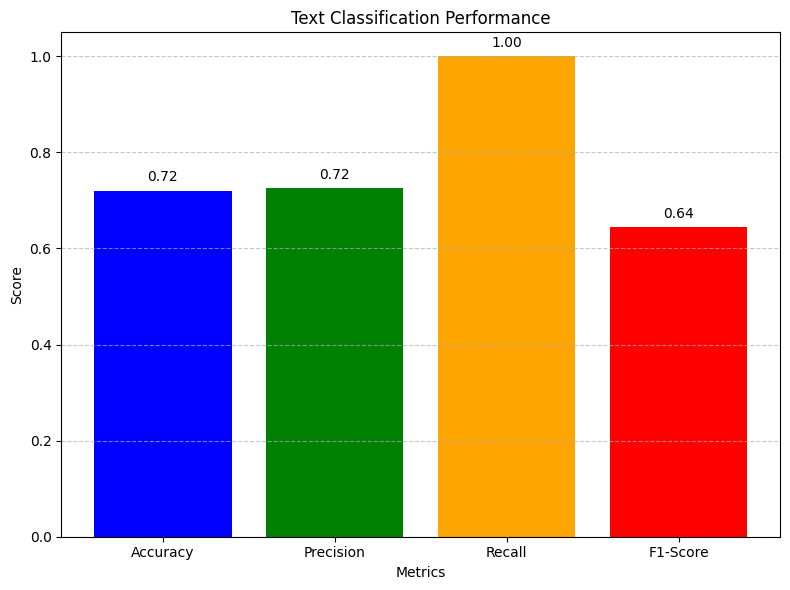

In [53]:
import matplotlib.pyplot as plt

# Define metrics and their corresponding values
metrics = ["Accuracy", "Precision", "Recall", "F1-Score"]
values = [0.72, 0.725, 1.0, 0.6444]

# Create a bar chart
plt.figure(figsize=(8, 6))  # Adjust figure size as desired
plt.bar(metrics, values, color=['blue', 'green', 'orange', 'red'])
plt.xlabel("Metrics")
plt.ylabel("Score")
plt.title("Text Classification Performance")

# Add data labels above bars (optional)
for i, v in enumerate(values):
  plt.text(i, v + 0.02, f"{v:.2f}", ha='center')  # Adjust offset for label placement

plt.grid(axis='y', linestyle='--', alpha=0.7)  # Add gridlines
plt.tight_layout()
plt.show()
